In [2]:
import sounddevice as sd
import scipy
import librosa
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import plotly as py
import soundfile as sf

### Запись

In [10]:
duration = 6 # Длительность записи в секундах
sample_rate = 44100 # Частота дискретизации (количество отсчетов в секунду)
filename = 'record.wav' # Имя файла для сохранения записи

# Записываем аудио в формате стерео
print("Recording...")
audio_data = sd.rec(int(duration * sample_rate), samplerate=sample_rate, channels=2, dtype='int16')
sd.wait()
print("Recording finished.")

# Сохраняем записанное аvудио
scipy.io.wavfile.write('../NewAudios/' + filename, sample_rate, audio_data)

Recording...
Recording finished.


### Загрузка

In [5]:
filename = 'record.wav' # Имя аудиофайла для загрузки

# Загружаем аудиоданные и частоту дискретизации
audio, sample_rate = librosa.load('../NewAudios/' + filename, sr=None)

print(f"Sample rate: {sample_rate}")
ipd.Audio(audio, rate=sample_rate)

Sample rate: 44100


### Визуализация формы волны

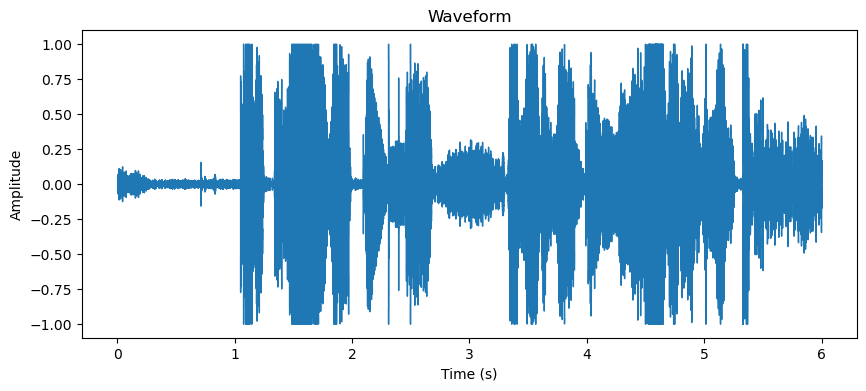

In [16]:
plt.figure(figsize=(10, 4))
librosa.display.waveshow(audio, sr=sample_rate) # Строим форму волны аудиосигнала
plt.title('Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

### Анализ частотного состава

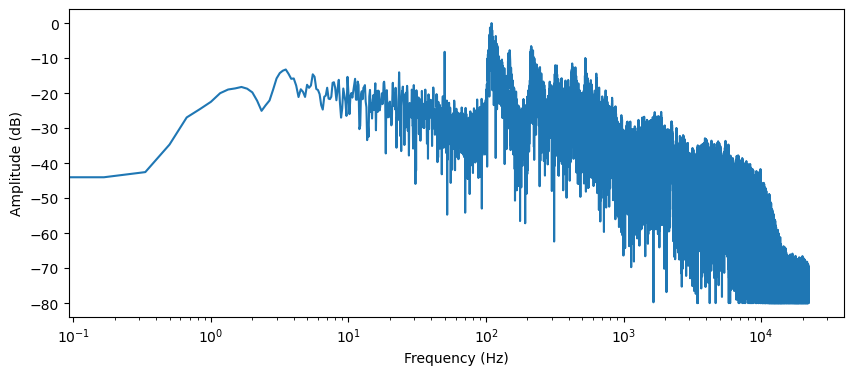

In [19]:
window = np.hanning(len(audio)) # Создаем окно Ханнинга длиной, равной аудиосигналу
windowed_input = audio * window # Применяем оконную функцию к аудиосигналу

# Вычисляем дискретное преобразование Фурье (DFT)
# с использованием быстрого преобразования Фурье (FFT)
dft = np.fft.rfft(windowed_input)

amplitude = np.abs(dft) # Вычисляем амплитудный спектр
amplitude_db = librosa.amplitude_to_db(amplitude, ref=np.max) # Преобразуем амплитудный спектр в шкалу децибел

# Получаем соответствующие частоты для преобразования Фурье
frequency = librosa.fft_frequencies(sr=sample_rate, n_fft=len(audio))

plt.figure(figsize=(10, 4))
plt.plot(frequency, amplitude_db)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Amplitude (dB)")
plt.xscale("log")

### Извлечение спектрограммы

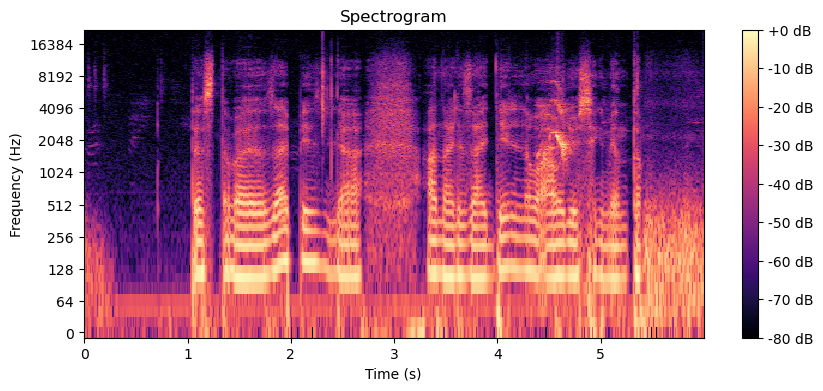

In [20]:
stft = librosa.stft(audio) # Вычисляем кратковременное преобразование Фурье (STFT), получая спектрограмму
spectrogram = librosa.amplitude_to_db(abs(stft), ref=np.max) # Преобразуем амплитудный спектр в децибелы

plt.figure(figsize=(10, 4))

# Отображаем спектрограмму
# x_axis='time' — отображаем ось времени
# y_axis='log' — логарифмическая шкала частот для лучшей видимости низкочастотных компонентов
librosa.display.specshow(spectrogram, sr=sample_rate, x_axis='time', y_axis='log')

plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram')
plt.xlabel("Time (s)")
plt.ylabel("Frequency (Hz)")
plt.show()

### Извлечение мел-спектрограммы

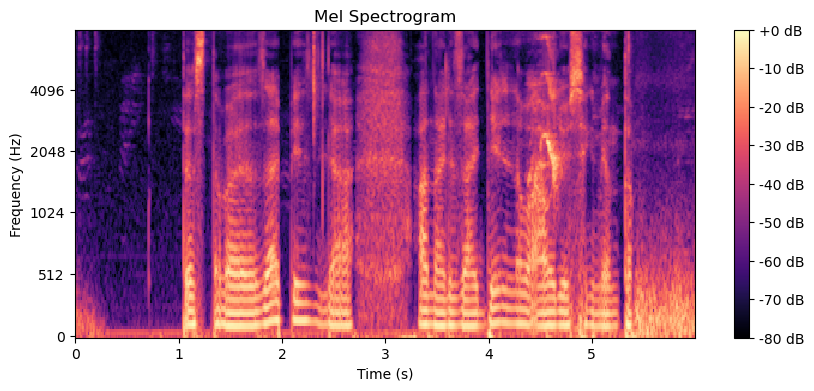

In [21]:
# Вычисляем мел-спектрограмму (MEL spectrogram)
# n_mels=128 — используем 128 мел-фильтров
# fmax=8000 — ограничиваем максимальную частоту 8 кГц
mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate, n_mels=128, fmax=8000)
mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max) # Преобразуем спектрограмму в шкалу децибел 

plt.figure(figsize=(10, 4))

# Отображаем мел-спектрограмму
# x_axis='time' — ось X представляет время
# y_axis='mel' — ось Y представляет частоты в мел-шкале
# fmax=8000 — ограничение верхней частоты до 8 кГц
librosa.display.specshow(mel_spectrogram_db, sr=sample_rate, x_axis='time', y_axis='mel', fmax=8000, cmap='magma')

plt.colorbar(format='%+2.0f dB')
plt.title('Mel Spectrogram')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.show()

### Извлечение мел-кепстральных коэффициентов 

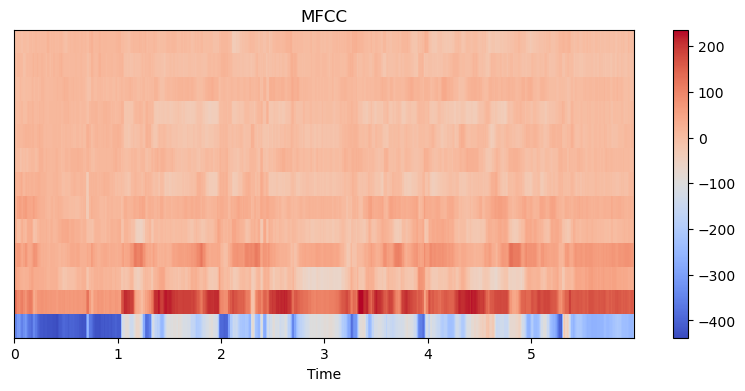

In [22]:
# Вычисляем мел-кепстральные коэффициенты (MFCC), которые описывают спектральные особенности звука
# y=audio — входной аудиосигнал
# sr=samplerate — частота дискретизации
# n_mfcc=13 — количество коэффициентов (обычно используют 12-13)
mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=13)

plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, sr=sample_rate, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.show()

### 3D-спектрогамма

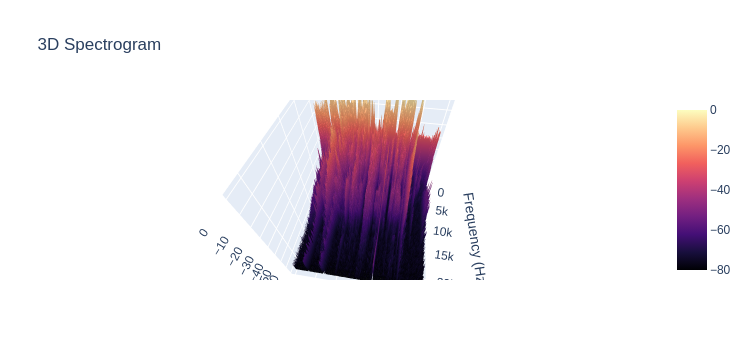

In [26]:
# Преобразуем номера кадров STFT в временные метки
times = librosa.frames_to_time(np.arange(spectrogram.shape[1]), sr=sample_rate)

# Получаем частоты, соответствующие коэффициентам преобразования Фурье
freqs = librosa.fft_frequencies(sr=sample_rate)

fig = py.graph_objs.Figure(data=[py.graph_objs.Surface(z=spectrogram, x=times, y=freqs, colorscale='Magma')])

fig.update_layout(
    title='3D Spectrogram',
    scene=dict(
        xaxis_title='Time (s)',
        yaxis_title='Frequency (Hz)',
        zaxis_title='Amplitude (dB)'
    ),
)

fig.show()
py.io.write_html(fig, '../DataSetInfo/3DSpectrogramExample.html')

### Реcэмплирование аудио

In [9]:
audio_resampled = librosa.resample(audio, orig_sr=sample_rate, target_sr=32000) # Изменяем частоту дискретизации аудиофайла
print(f"Original Sample Rate: {sample_rate}, Resampled Sample Rate: 8000")
ipd.Audio(audio_resampled, rate=sample_rate)

Original Sample Rate: 44100, Resampled Sample Rate: 8000


### Добавление шума (для аугментации данных)

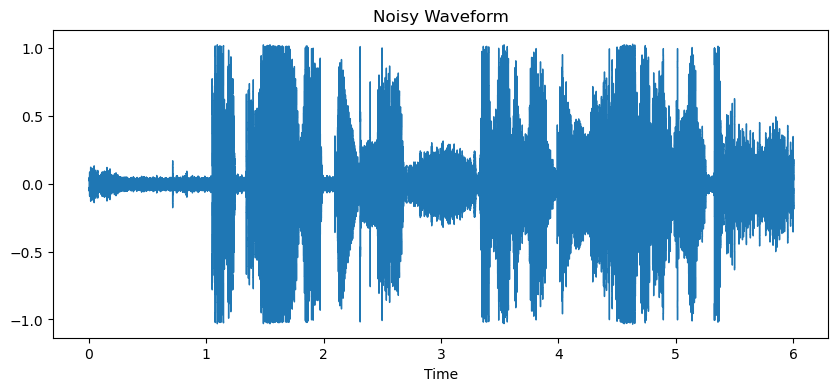

In [10]:
# Генерируем белый шум
# np.random.normal(0, 0.01, audio.shape) создает шум с нормальным распределением
# 0 — среднее значение (то есть шум центрирован вокруг нуля)
# 0.01 — стандартное отклонение (интенсивность шума)
# audio.shape — шум будет такой же длины, как аудиосигнал
noise = np.random.normal(0, 0.01, audio.shape)
audio_noisy = audio + noise # Добавляем шум к исходному аудиосигналу

# Отображаем волновую форму аудиосигнала с шумом
plt.figure(figsize=(10, 4))
librosa.display.waveshow(audio_noisy, sr=sample_rate)
plt.title('Noisy Waveform')
plt.show()

ipd.Audio(audio_noisy, rate=sample_rate)

### Сохранение обработанного аудио

In [13]:
sf.write('../NewAudios/noisy_record.wav', audio_noisy, sample_rate)